## Columnes
genre: The genre in which the track belongs.

artist_name: The artists' names who performed the track

track_name: Name of the track

track_id: The Spotify ID for the track

popularity: The popularity of a track is a value between 0 and 100

acousticness: A confidence measure from 0.0 to 1.0 of whether the track is acoustic

danceability: Danceability describes how suitable a track is for dancing based

duration_ms: The track length in milliseconds

energy: Measure of intensity and activity from 0.0 to 1.0

instrumentalness: Predicts whether a track contains no vocals (nearer 1=no vocals)

key: The key the track is in

liveness: Detects the presence of an audience in the recording (higher 0.8=live)

loudness: The overall loudness of a track in decibels (dB)

mode: Mode indicates the scale (major or minor) of a track

speechiness: Speechiness detects the presence of spoken words in a track

tempo: The overall estimated tempo of a track in beats per minute

time_signature: An estimated time signature

valence: A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track

# A) Carregar llibreries

In [1]:
##A)Carregar llibreries
import pandas as pd ###py -m pip install pandas
import numpy as np ###py -m pip install numypy

from sklearn.decomposition import PCA, KernelPCA, TruncatedSVD ###py -m pip install scikit-learn
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.cluster import KMeans, HDBSCAN, DBSCAN, MiniBatchKMeans 
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture

from yellowbrick.cluster import KElbowVisualizer ##py -m pip install yellowbrick

import seaborn as sns ##py -m pip install seaborn

import random

import matplotlib.pyplot as plt ##py -m pip install matplotlib

from scipy.spatial.distance import euclidean

# B) Carregar dataset

In [2]:
##B)Carregar el dataset
df = pd.read_csv('SpotifyFeatures.csv')
#print(df.head()) #Mostra 5 rows
print(df.info()) #Mostra el tipus de columns: df.dtypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232725 entries, 0 to 232724
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   genre             232725 non-null  object 
 1   artist_name       232725 non-null  object 
 2   track_name        232724 non-null  object 
 3   track_id          232725 non-null  object 
 4   popularity        232725 non-null  int64  
 5   acousticness      232725 non-null  float64
 6   danceability      232725 non-null  float64
 7   duration_ms       232725 non-null  int64  
 8   energy            232725 non-null  float64
 9   instrumentalness  232725 non-null  float64
 10  key               232725 non-null  object 
 11  liveness          232725 non-null  float64
 12  loudness          232725 non-null  float64
 13  mode              232725 non-null  object 
 14  speechiness       232725 non-null  float64
 15  tempo             232725 non-null  float64
 16  time_signature    23

# C) Preparar dades

In [3]:
#1) Corretgir valors errònis (impossibles)
#Comprovar valors de key, mode i time_signature
#print("Key values:", df['key'].value_counts())
#print("Mode values:", df["mode"].value_counts())
#print("Time_signature values:", df["time_signature"].value_counts())
#print("Genre values::", df["genre"].value_counts())

#Eliminar key: "0/4" (impossible)
print("Quantitat de '0/4'abans:", (df["time_signature"] == "0/4").sum()) #Quantitat key: "0/4"
df = df[df["time_signature"] != "0/4"]
print("Quantitat de '0/4' després:", (df["time_signature"] == "0/4").sum())
print("New shape sense '0/4':", df.shape)

#Substituir Children’s Music per Children's Music 
print("Quantitat de Children’s Music abans:", (df["genre"] == "Children’s Music").sum()) 
print("Quantitat de Children's Music abans:", (df["genre"] == "Children's Music").sum()) 
df.loc[df["genre"]=="Children’s Music", "genre"] = "Children's Music"
print("Quantitat de Children’s Music desrpés:", (df["genre"] == "Children’s Music").sum()) 
print("Quantitat de Children's Music després:", (df["genre"] == "Children's Music").sum()) 
print("New valors de genre sense Children’s Music :", df["genre"].nunique())

#Eliminar NaN
print("Quantitat de Nan abans:", df.isna().sum().sum()) #Quantitat Nan en tot df
#print("NaN per features:", df.isna().sum())
df.dropna(axis=0, inplace=True) #
print("Quantitat de Nan després:", df.isna().sum().sum())
print("New shape sense Nan:", df.shape)

Quantitat de '0/4'abans: 8
Quantitat de '0/4' després: 0
New shape sense '0/4': (232717, 18)
Quantitat de Children’s Music abans: 9353
Quantitat de Children's Music abans: 5403
Quantitat de Children’s Music desrpés: 0
Quantitat de Children's Music després: 14756
New valors de genre sense Children’s Music : 26
Quantitat de Nan abans: 1
Quantitat de Nan després: 0
New shape sense Nan: (232716, 18)


In [4]:
#2)Codificar columnes no numèriques
#Genre amb OneHotEncoder i resta amb frequencia
df2 = df.copy(deep=True)

freq = df2["key"].value_counts(normalize=True)
df2["key"] = df2["key"].map(freq)
#Codificar columna mode 
freq = df["mode"].value_counts(normalize=True)
df2["mode"] = df2["mode"].map(freq)
#Codificar columna time_signature
freq = df2["time_signature"].value_counts(normalize=True)
df2["time_signature"] = df2["time_signature"].map(freq)
#Codificar columna genre
enc = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
df_temp = df2[['genre']].copy()
encoded_array = enc.fit_transform(df_temp)
feature_names = enc.get_feature_names_out(['genre'])
encoded_df = pd.DataFrame(encoded_array, columns=feature_names, index=df2.index)
print("Nova shape df2:", df2.shape)
print("Noves columnas:", df2.columns)

Nova shape df2: (232716, 18)
Noves columnas: Index(['genre', 'artist_name', 'track_name', 'track_id', 'popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence'],
      dtype='object')


In [5]:
#3) Fer combinació de gèneres a partir de la codificació OHE
#Dataframe auxiliar on es combinen les columnes de generes
tmp = pd.concat([df2['track_id'], encoded_df], axis=1)
func = {feature: "sum" for feature in feature_names}
tmp = tmp.groupby(tmp["track_id"]).aggregate(func)

#Treure duplicats a df2
df2.drop_duplicates(subset="track_id", keep="first", inplace=True, ignore_index=True)

#Guardar columnes: 'track_name', 'artist_name' 
canciones = df2[["track_name", "artist_name"]]

#Drop columnes: artist_name, track_name
df2.drop(['artist_name','track_name'], axis=1, inplace=True)

num_col = df2.select_dtypes(exclude="object").columns
cat_col = df2.select_dtypes(include="object").columns

#Ajuntar df2 amb tmp segons track_id
df2 = df2.join(tmp, on="track_id")

#Drop olumnes: 'track_id' i 'genre'
df2.drop(['track_id', 'genre'], axis=1, inplace=True) #Elimina les columnes modificant df og
print(f"Nova shape sense artist_name, track_name, track_id, genre: {df2.shape}") #Mostra rowsxcolumns

Nova shape sense artist_name, track_name, track_id, genre: (176767, 40)


(array([[<Axes: title={'center': 'popularity'}>,
         <Axes: title={'center': 'acousticness'}>,
         <Axes: title={'center': 'danceability'}>,
         <Axes: title={'center': 'duration_ms'}>,
         <Axes: title={'center': 'energy'}>,
         <Axes: title={'center': 'instrumentalness'}>],
        [<Axes: title={'center': 'key'}>,
         <Axes: title={'center': 'liveness'}>,
         <Axes: title={'center': 'loudness'}>,
         <Axes: title={'center': 'mode'}>,
         <Axes: title={'center': 'speechiness'}>,
         <Axes: title={'center': 'tempo'}>],
        [<Axes: title={'center': 'time_signature'}>,
         <Axes: title={'center': 'valence'}>,
         <Axes: title={'center': 'genre_A Capella'}>,
         <Axes: title={'center': 'genre_Alternative'}>,
         <Axes: title={'center': 'genre_Anime'}>,
         <Axes: title={'center': 'genre_Blues'}>],
        [<Axes: title={'center': "genre_Children's Music"}>,
         <Axes: title={'center': 'genre_Classical'}>,

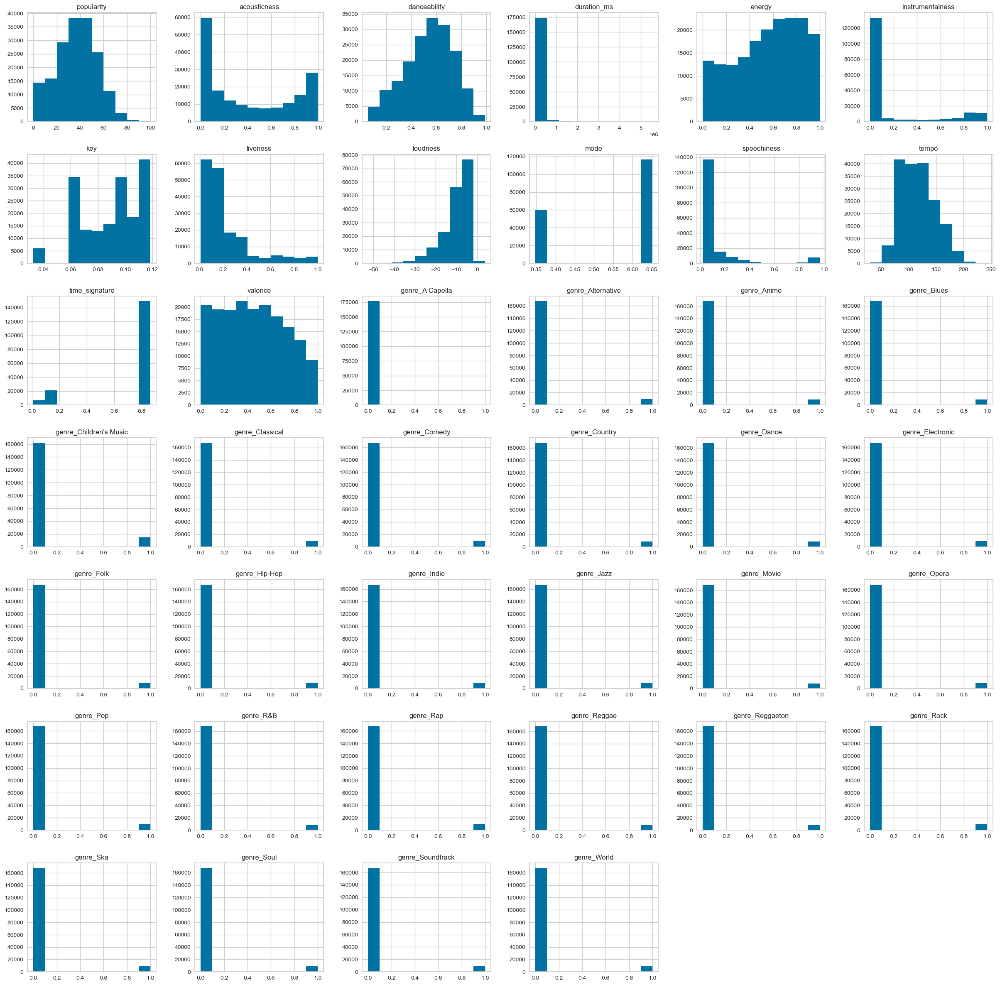

In [6]:
#5) Mirar histograma
df2.hist(figsize=(30, 30)), 

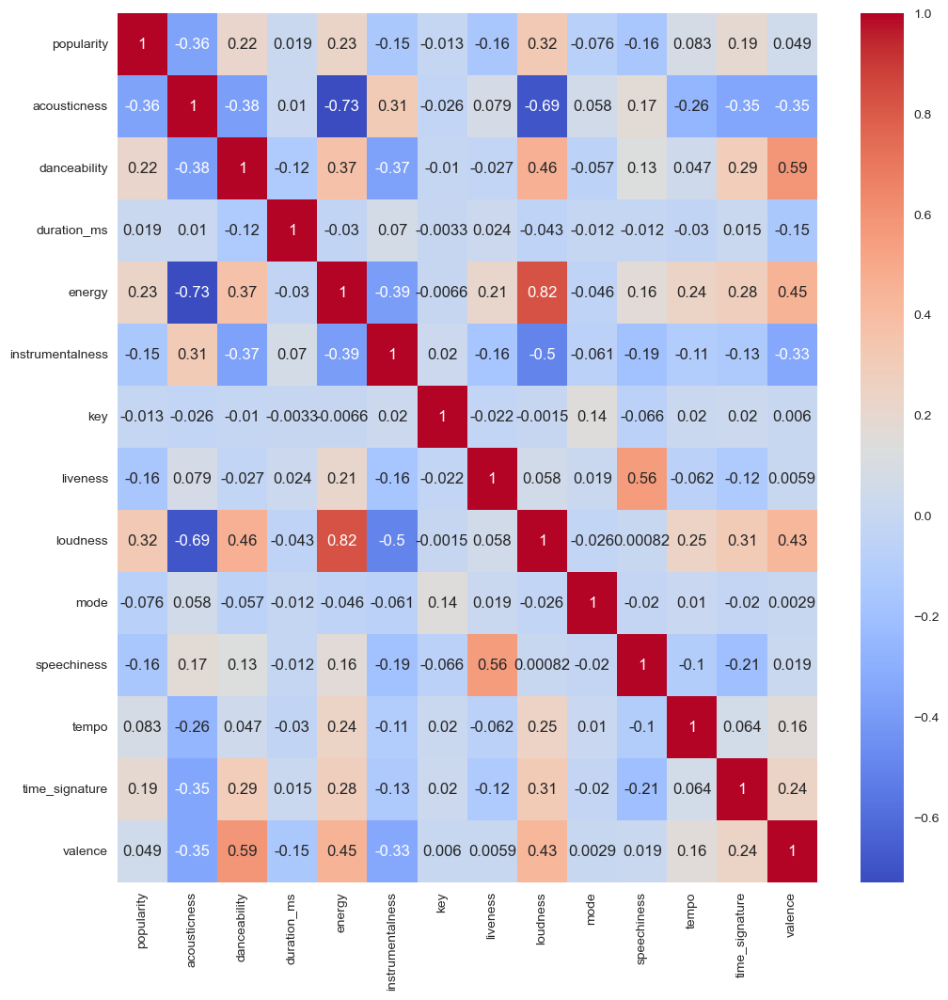

In [7]:
#6) Mirar correlació (pearson)
corr_matrix3 = df2[num_col].corr()
plt.figure(figsize=(12, 12))
ax = sns.heatmap(corr_matrix3, annot=True, cmap='coolwarm')
plt.show()

In [8]:
#7) Escalar columnes
scaler = StandardScaler()
data2_scal = scaler.fit_transform(df2)
#df2_scal = pd.DataFrame(data=scaler.fit_transform(data), columns=data.columns)

# D) Establir model

## 1) KMeans

Exception in thread Thread-10 (_readerthread):
Traceback (most recent call last):
  File "c:\Users\gaofu\anaconda3\Lib\threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "c:\Users\gaofu\anaconda3\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "c:\Users\gaofu\anaconda3\Lib\threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "c:\Users\gaofu\anaconda3\Lib\subprocess.py", line 1597, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xa2 in position 116: invalid start byte


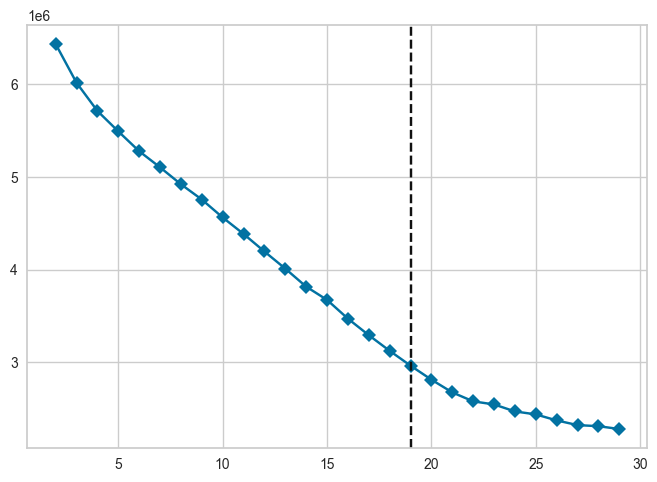

In [ ]:
#DATASET3
#1) Calcular k millor
model = KMeans(n_init=10, random_state=0)
visualizer = KElbowVisualizer(model, k=(2,30), timings=False, metric='distortion') #default distance_metric: euclidean
visualizer.fit(data2_scal)       
#visualizer.show() #Quitar en py
#visualizer.show(outpath="kmeans.png") #Guardar gráfica
k = visualizer.elbow_value_ #millor k
#2) Entrenar i predir amb KMEANS
kmeans = KMeans(n_clusters=k, n_init=10, random_state=0)
#kmeans = MiniBatchKMeans(n_clusters=k, n_init=10, random_state=0)
kmeans1 = kmeans.fit_predict(data2_scal) #Mateix que: kmeans.labels__
#data_scal["cluster"] = pred

## 2) DBSCAN

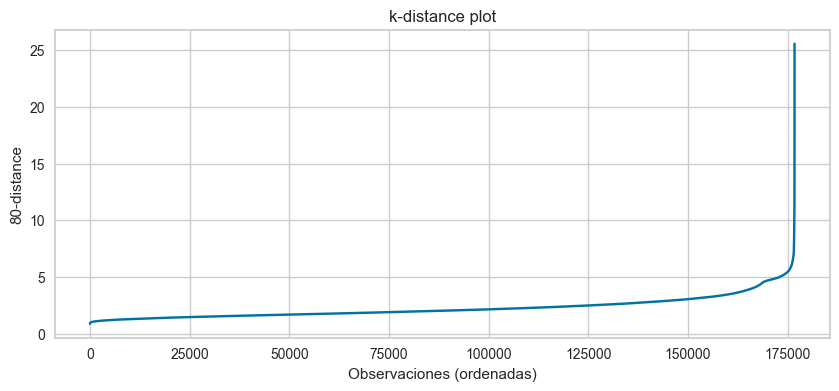

5.445476051485184


In [ ]:
#DATASET3
#1) Calcular eps
min_samples = 2 * data2_scal.shape[1]
nn = NearestNeighbors(n_neighbors=min_samples).fit(data2_scal) #default algorithm: auto; most appropiate, default metric: minkowski
dists, _ = nn.kneighbors(data2_scal)
kdist = np.sort(dists[:, -1])
plt.figure(figsize=(10,4))
plt.plot(kdist, label=f'{min_samples}-distance sorted')
plt.title('k-distance plot')
plt.xlabel('Observaciones (ordenadas)')
plt.ylabel(f'{min_samples}-distance')
plt.savefig("dbscan.png")
plt.show()
print(kdist[175000])

In [ ]:
#2) Entrenar i predir amb DBSCAN
min_samples = 2 * data2_scal.shape[1]
dbscan = DBSCAN(eps=5, min_samples=min_samples, n_jobs=-1,) #default algorithm: auto of NearestNeighbours; most appropiate
dbscan1 = dbscan.fit_predict(data2_scal)
#print(calinski_harabasz_score(data2_scal, dbscan1), davies_bouldin_score(data2_scal, dbscan1))

## 3) HDBSCAN

In [ ]:
#DATASET3
#1) Entrenar i predir amb HDBSCAN
min_samples = 2 * data2_scal.shape[1]
hdbscan = HDBSCAN(min_cluster_size=min_samples, min_samples=min_samples, n_jobs=-1, store_centers="centroid") #default metric: euclidean
hdbscan1 = hdbscan.fit_predict(data2_scal)

## 4) Gaussian Mixture

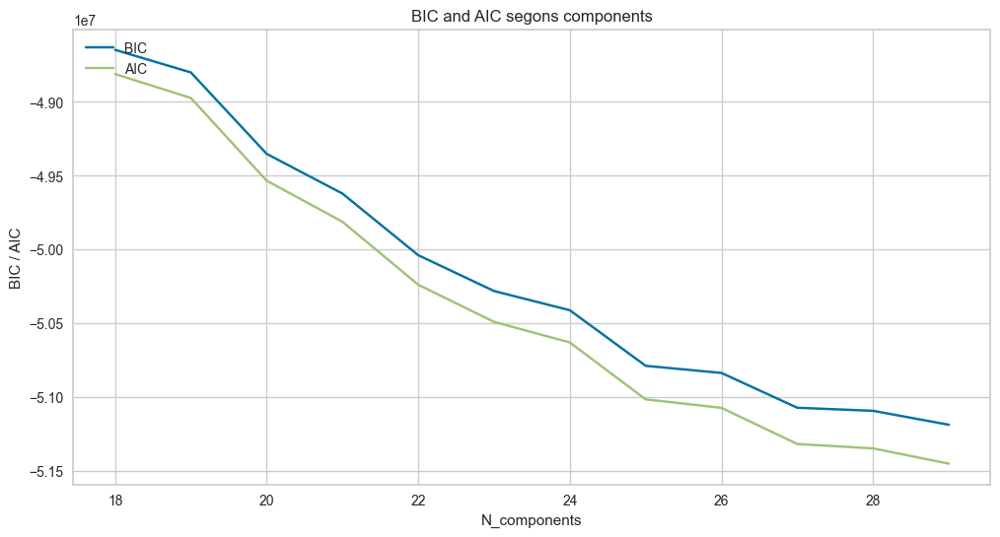

In [ ]:
#DATASET3
#1) Trobar n_components
n_components_range = range(18, 30)
bics = []
aics = []

for n in n_components_range:
    gmm = GaussianMixture(n_components=n, n_init=10, random_state=0)
    gmm.fit(data2_scal)
    bics.append(gmm.bic(data2_scal))
    aics.append(gmm.aic(data2_scal))

plt.figure(figsize=(12, 6))
plt.plot(n_components_range, bics, label='BIC')
plt.plot(n_components_range, aics, label='AIC')
plt.xlabel('N_components')
plt.ylabel('BIC / AIC')
plt.legend(loc=2)
plt.title('BIC and AIC segons components')
plt.savefig("gm.png")
plt.show()

In [ ]:
#DATASET3
#2) Entrenar i predir amb GM
gm = GaussianMixture(n_components=25, n_init=10, random_state=0) #default covariance_type: full 
gm1 = gm.fit_predict(data2_scal)

# E) Evaluar models

In [ ]:
#KMEANS
print(calinski_harabasz_score(data2_scal, kmeans1), davies_bouldin_score(data2_scal, kmeans1))

13627.543198061208 1.4430137550177833


In [ ]:
#DBSCAN
print(calinski_harabasz_score(data2_scal, dbscan1), davies_bouldin_score(data2_scal, dbscan1))

2584.8444416776424 1.9799914088239967


In [ ]:
#HDBSCAN
print(calinski_harabasz_score(data2_scal, hdbscan1), davies_bouldin_score(data2_scal, hdbscan1))

4558.467800538003 0.23138722287994212


In [ ]:
#GaussianMixture
print(calinski_harabasz_score(data2_scal, gm1), davies_bouldin_score(data2_scal, gm1))

21364.7696365001 0.8837005835017352


In [20]:
len(set(kmeans1)), len(set(dbscan1)), len(set(hdbscan1))
#len(set(kmeans1)), len(set(dbscan1)), len(set(hdbscan1)), len(set(gm1))

(19, 3, 2)

# F) Visualitzar clústers

In [ ]:
# Crear sampled dataset per proves més ràpides
# Samplearem 15% de les dades per a proves
sample_size = int(len(df2) * 0.15)
#sample_size = int(len(df) * 0.15 / len(set(hdbscan1)))

#df2_kmeans1 = pd.DataFrame(data=data2_scal, columns=df2.columns)
#df2_kmeans1["label"] = hdbscan1
#sample_indices = df2_kmeans1.groupby("label").apply(lambda x: x.sample(sample_size, random_state=0) if len(x) >= sample_size else x, include_groups=False).droplevel("label").index
sample_indices = np.random.RandomState(42).choice(len(df2), sample_size, replace=False)

df2_sample = data2_scal[sample_indices]
#pred= pred[sample_indices]
print("Mida orignal:", df2.shape)
print("Mida 20%:", df2_sample.shape)

Mida orignal: (176767, 40)
Mida 20%: (26515, 40)


## 1) HDBSCAN

In [26]:
# 1. PCA Estàndard
pca_sample = PCA(n_components=2, random_state=42)
df2_sample_pca = pca_sample.fit_transform(df2_sample)

df2_sample_pca_2 = pd.DataFrame(data=df2_sample_pca, columns=['Component 1', 'Component 2'])
df2_sample_pca_2["kmeans"] = kmeans1[sample_indices]
df2_sample_pca_2["dbscan"] = dbscan1[sample_indices]
df2_sample_pca_2["hdbscan"] = hdbscan1[sample_indices]

# 2. KernelPCA RBF
kpca_sample = KernelPCA(n_components=2, kernel='rbf', random_state=42, n_jobs=-1)
df2_sample_kpca = kpca_sample.fit_transform(df2_sample)

df2_sample_kpca_2 = pd.DataFrame(data=df2_sample_kpca, columns=['Component 1', 'Component 2'])
df2_sample_kpca_2["kmeans"] = kmeans1[sample_indices]
df2_sample_kpca_2["dbscan"] = dbscan1[sample_indices]
df2_sample_kpca_2["hdbscan"] = hdbscan1[sample_indices]

# 3. TruncatedSVD
tsvd_sample = TruncatedSVD(n_components=2, random_state=42)
df2_sample_tsvd = tsvd_sample.fit_transform(df2_sample)

df2_sample_tsvd_2 = pd.DataFrame(data=df2_sample_tsvd, columns=['Component 1', 'Component 2'])
df2_sample_tsvd_2["kmeans"] = kmeans1[sample_indices]
df2_sample_tsvd_2["dbscan"] = dbscan1[sample_indices]
df2_sample_tsvd_2["hdbscan"] = hdbscan1[sample_indices]

# 4. TSNE
tsne = TSNE(n_components=2, perplexity=150, learning_rate='auto', random_state=42)
df2_sample_tsne = tsne.fit_transform(df2_sample)
df2_sample_tsne_2 = pd.DataFrame(data=df2_sample_tsne, columns=['Component 1', 'Component 2'])
df2_sample_tsne_2["kmeans"] = kmeans1[sample_indices]
df2_sample_tsne_2["dbscan"] = dbscan1[sample_indices]
df2_sample_tsne_2["hdbscan"] = hdbscan1[sample_indices]

In [27]:
pca_sample.explained_variance_ratio_.cumsum(), tsvd_sample.explained_variance_ratio_.cumsum(), tsne.kl_divergence_

(array([0.11771015, 0.18834716]),
 array([0.11771015, 0.18834673]),
 0.7745547294616699)

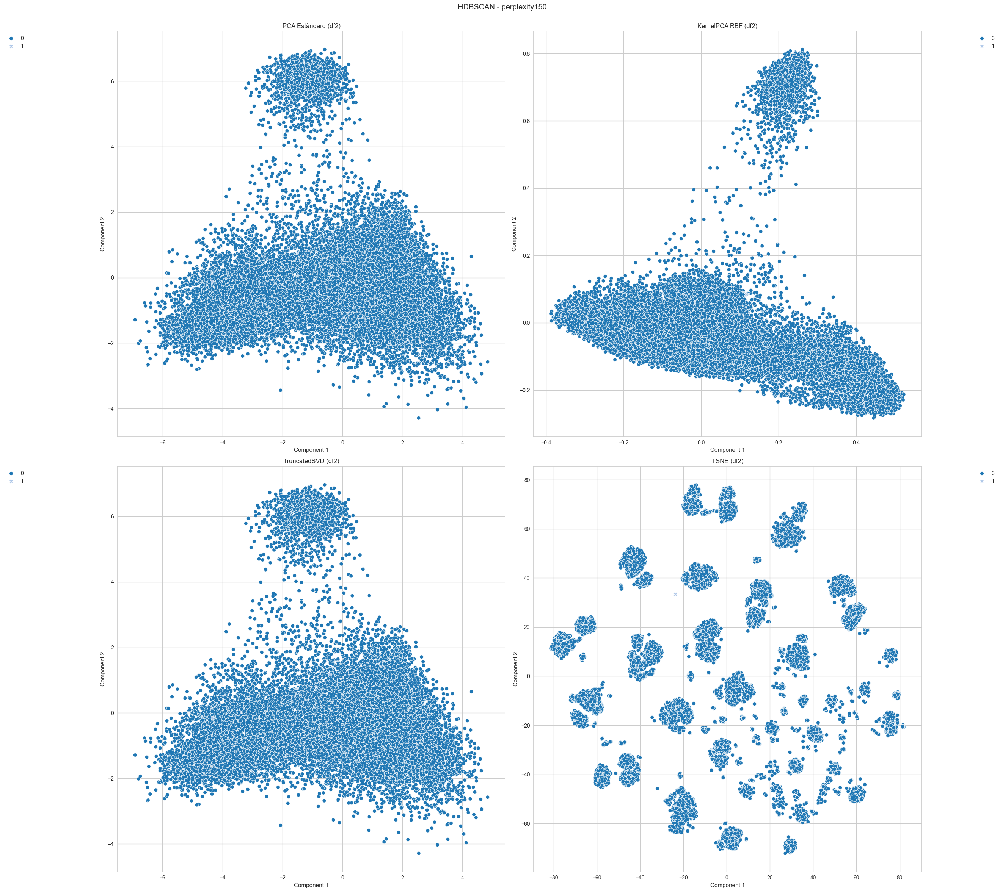

In [28]:
#HDBSCAN
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
#df2_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_pca_2, x='Component 1', y='Component 2', hue='hdbscan', style='hdbscan',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df2)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
#df2_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_kpca_2, x='Component 1', y='Component 2', hue='hdbscan',  style='hdbscan',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df2)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
#df2_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsvd_2, x='Component 1', y='Component 2', hue='hdbscan',  style='hdbscan',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df2)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
#df2_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsne_2, x='Component 1', y='Component 2', hue='hdbscan', style='hdbscan',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df2)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.suptitle(f"HDBSCAN - perplexity{tsne.perplexity}")
fig.subplots_adjust(top=0.95)
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

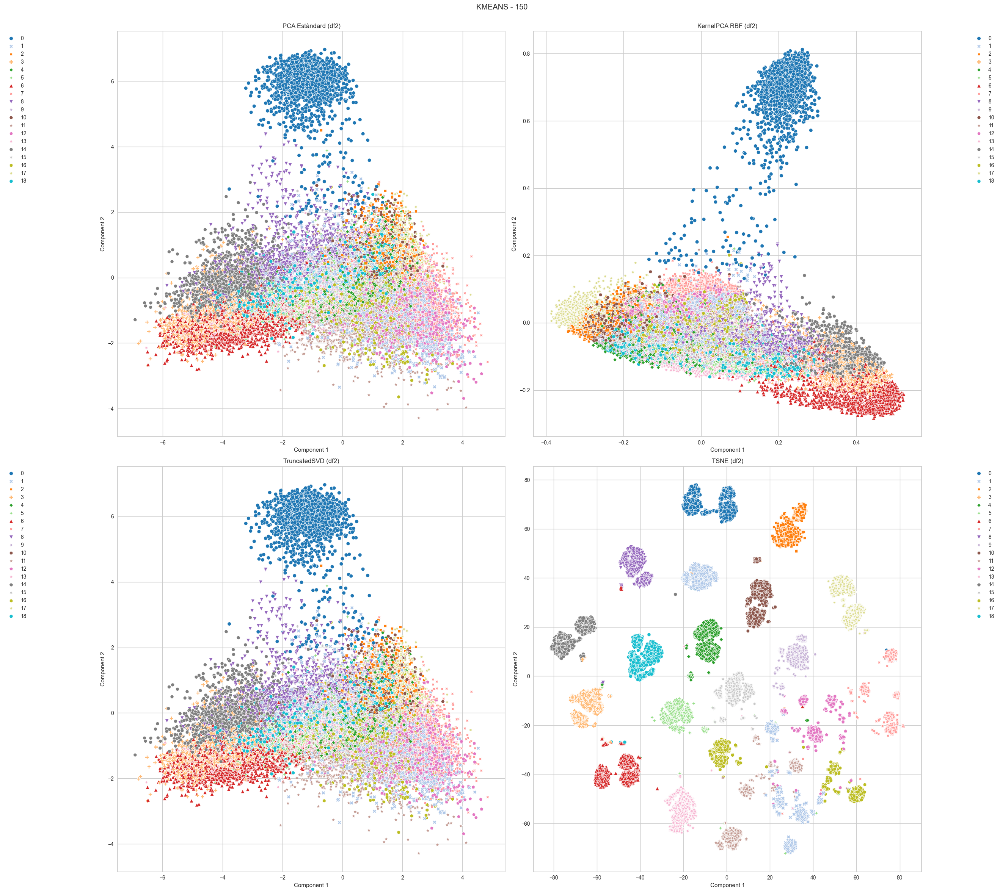

In [35]:
#KMEANS
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
#df2_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_pca_2, x='Component 1', y='Component 2', hue='kmeans', style='kmeans',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df2)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
#df2_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_kpca_2, x='Component 1', y='Component 2', hue='kmeans',  style='kmeans',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df2)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
#df2_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsvd_2, x='Component 1', y='Component 2', hue='kmeans',  style='kmeans',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df2)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
#df2_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsne_2, x='Component 1', y='Component 2', hue='kmeans', style='kmeans',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df2)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.suptitle(f"KMEANS - {tsne.perplexity}")
fig.subplots_adjust(top=0.95)
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

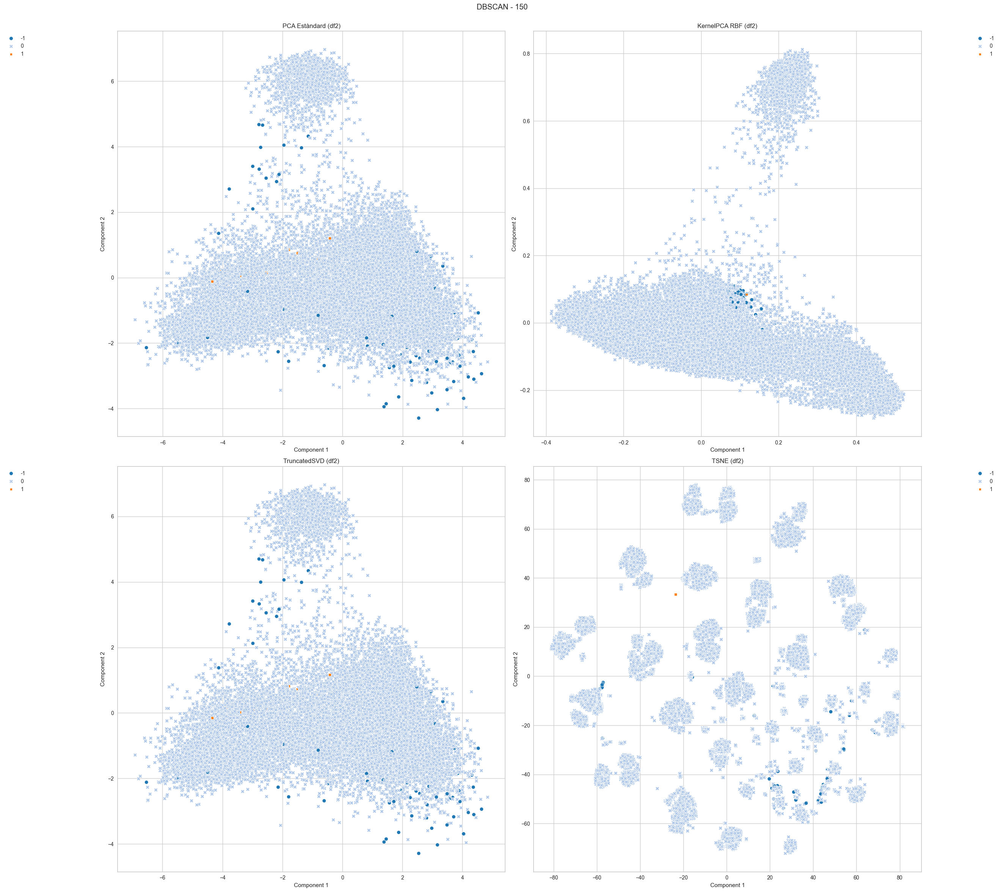

In [36]:
#DBSCAN
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
#df2_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_pca_2, x='Component 1', y='Component 2', hue='dbscan', style='dbscan',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df2)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
#df2_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_kpca_2, x='Component 1', y='Component 2', hue='dbscan',  style='dbscan',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df2)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
#df2_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsvd_2, x='Component 1', y='Component 2', hue='dbscan',  style='dbscan',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df2)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
#df2_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsne_2, x='Component 1', y='Component 2', hue='dbscan', style='dbscan',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df2)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.suptitle(f"DBSCAN - {tsne.perplexity}")
fig.subplots_adjust(top=0.95)
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

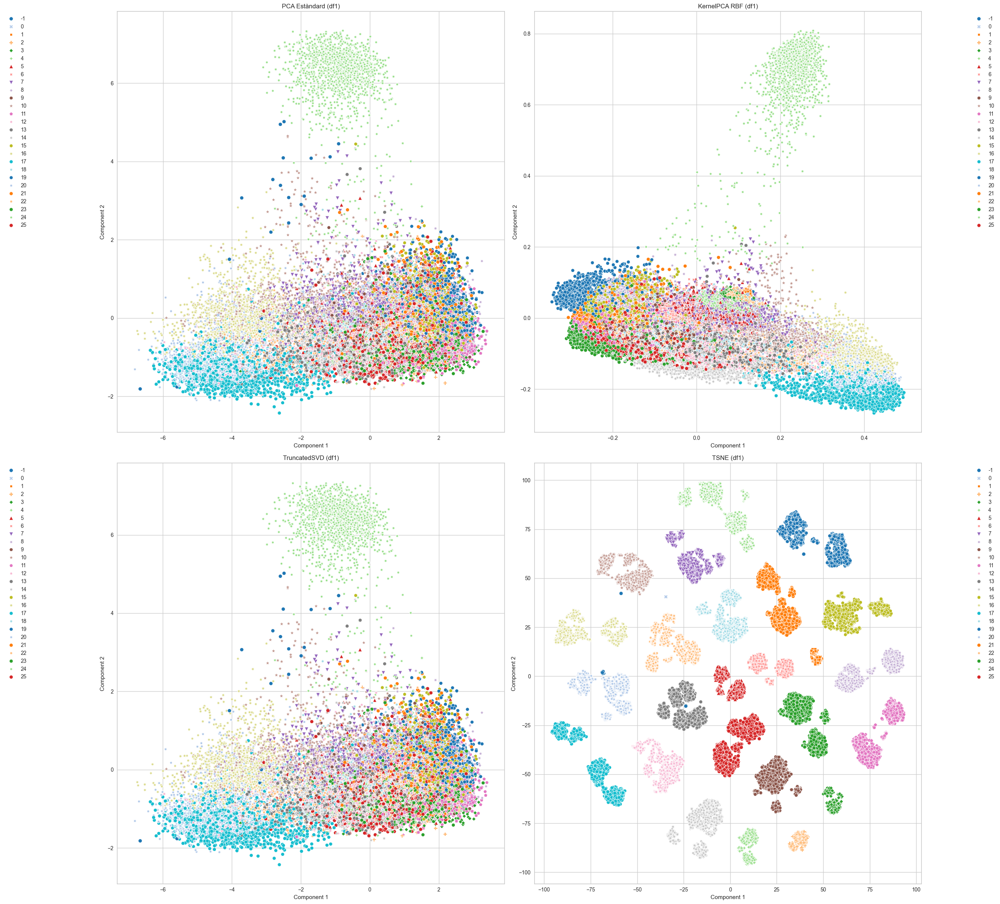

In [ ]:
#BASE NO EJECUTAR
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
pca_sample = PCA(n_components=2, random_state=42)
df2_sample_pca = pca_sample.fit_transform(df2_sample)

df2_sample_pca_2 = pd.DataFrame(data=df2_sample_pca, columns=['Component 1', 'Component 2'])
df2_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_pca_2, x='Component 1', y='Component 2', hue='Cluster', style='Cluster',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df2)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
kpca_sample = KernelPCA(n_components=2, kernel='rbf', random_state=42, n_jobs=-1)
df2_sample_kpca = kpca_sample.fit_transform(df2_sample)

df2_sample_kpca_2 = pd.DataFrame(data=df2_sample_kpca, columns=['Component 1', 'Component 2'])
df2_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_kpca_2, x='Component 1', y='Component 2', hue='Cluster',  style='Cluster',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df2)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
tsvd_sample = TruncatedSVD(n_components=2, random_state=42)
df2_sample_tsvd = tsvd_sample.fit_transform(df2_sample)

df2_sample_tsvd_2 = pd.DataFrame(data=df2_sample_tsvd, columns=['Component 1', 'Component 2'])
df2_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df2_sample_tsvd_2, x='Component 1', y='Component 2', hue='Cluster',  style='Cluster',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df2)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
tsne = TSNE(n_components=2, perplexity=50, learning_rate='auto', random_state=42)
df2_sample_tsne = tsne.fit_transform(df2_sample)
df2_sample_tsne_2 = pd.DataFrame(data=df2_sample_tsne, columns=['Component 1', 'Component 2'])
df2_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]

sns.scatterplot(data=df2_sample_tsne_2, x='Component 1', y='Component 2', hue='Cluster', style='Cluster',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df2)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

# H) Anàlisi

In [51]:
df2_kmeans1.describe()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,...,genre_R&B,genre_Rap,genre_Reggae,genre_Reggaeton,genre_Rock,genre_Ska,genre_Soul,genre_Soundtrack,genre_World,label
count,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,...,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,1.767670e+05,176767.000000
mean,3.344355e-17,7.074597e-18,2.765524e-16,-3.891028e-17,-6.391255e-17,-1.003306e-16,3.131313e-16,6.560080e-17,1.350605e-17,-8.360887e-17,...,5.788306e-17,-4.630645e-17,1.119073e-16,6.560080e-17,-5.916935e-17,-2.443952e-17,4.116129e-17,8.489516e-17,1.723629e-16,8.703429
std,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,...,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,5.610931
min,-2.085761e+00,-1.103272e+00,-2.543147e+00,-1.691308e+00,-2.019391e+00,-5.328408e-01,-2.706497e+00,-1.018185e+00,-6.617382e+00,-1.392327e+00,...,-2.315072e-01,-2.347309e-01,-2.284941e-01,-2.306243e-01,-2.352804e-01,-2.299024e-01,-2.328199e-01,-2.402471e-01,-2.328874e-01,0.000000
25%,-6.482305e-01,-9.787820e-01,-6.622150e-01,-4.434271e-01,-7.723367e-01,-5.328408e-01,-7.214088e-01,-6.019741e-01,-4.241786e-01,-1.392327e+00,...,-2.315072e-01,-2.347309e-01,-2.284941e-01,-2.306243e-01,-2.352804e-01,-2.299024e-01,-2.328199e-01,-2.402471e-01,-2.328874e-01,4.000000
50%,4.178433e-02,-3.170209e-01,8.889709e-02,-1.277522e-01,1.267556e-01,-5.326228e-01,3.456971e-01,-4.479625e-01,3.043324e-01,7.182221e-01,...,-2.315072e-01,-2.347309e-01,-2.284941e-01,-2.306243e-01,-2.352804e-01,-2.299024e-01,-2.328199e-01,-2.402471e-01,-2.328874e-01,9.000000
75%,7.317992e-01,1.056188e+00,7.454636e-01,2.483913e-01,8.409539e-01,-2.516705e-01,6.295986e-01,2.486439e-01,7.046304e-01,7.182221e-01,...,-2.315072e-01,-2.347309e-01,-2.284941e-01,-2.306243e-01,-2.352804e-01,-2.299024e-01,-2.328199e-01,-2.402471e-01,-2.328874e-01,14.000000
max,3.664362e+00,1.615846e+00,2.352738e+00,4.073731e+01,1.602282e+00,2.560652e+00,1.337433e+00,3.674810e+00,2.170565e+00,7.182221e-01,...,4.319520e+00,4.260197e+00,4.376480e+00,4.336057e+00,4.250247e+00,4.349673e+00,4.295166e+00,4.162382e+00,4.293921e+00,18.000000


In [49]:
df2_kmeans1.groupby(by=["label"]).describe()

popularity                                                              \
           count      mean       std       min       25%       50%       75%   
label                                                                          
0         9692.0 -0.861920  0.484525 -2.085761 -1.223243 -0.935737 -0.590729   
1        16193.0 -0.009275  1.381187 -2.085761 -1.855756  0.559295  1.019305   
2         8097.0 -0.497095  0.585104 -1.798255 -0.935737 -0.590729 -0.188221   
3         8393.0 -0.421357  0.808695 -2.085761 -0.648231 -0.303223  0.041784   
4         9031.0  0.082687  0.545857 -2.085761 -0.303223  0.041784  0.386792   
5         8525.0  0.225100  0.551655 -2.085761 -0.073218  0.214288  0.559295   
6         9338.0 -0.138164  0.506390 -2.085761 -0.475727 -0.188221  0.156787   
7         9835.0  1.290985  0.499728 -2.085761  0.904303  1.191809  1.594318   
8         7617.0 -1.420696  0.755754 -2.085761 -2.028260 -1.683253 -0.993238   
9         8364.0  0.552262  0.560737 -2.085761  0.156787  0.444293  0.846802   
10        8703.0 -0.045257  0.613860 -2.085761 -0.475727 -0.130719  0.329291   
11       10732.0  0.809457  0.465693 -2.085761  0.501794  0.731799  1.076807   
12        9024.0  1.338939  0.669827 -2.085761  0.961804  1.364313  1.766821   
13        8347.0 -0.086197  0.507595 -1.913258 -0.418226 -0.130719  0.214288   
14        8312.0 -1.337588  0.465508 -2.085761 -1.683253 -1.453248 -1.108240   
15        8431.0 -0.137956  0.527260 -2.085761 -0.475727 -0.188221  0.099286   
16       10559.0  0.584493  0.468192 -2.085761  0.271789  0.559295  0.846802   
17        8911.0  0.080927  0.775783 -2.085761 -0.475727 -0.073218  0.559295   
18        8663.0 -0.700993  0.555975 -2.085761 -1.108240 -0.763233 -0.360724   

                acousticness            ... genre_Soundtrack            \
            max        count      mean  ...              75%       max   
label                                   ...                              
0      1.134308       9692.0  1.062903  ...        -0.240247 -0.240247   
1      3.089350      16193.0 -0.295733  ...        -0.240247 -0.240247   
2      1.939325       8097.0 -0.864216  ...        -0.240247 -0.240247   
3      1.881824       8393.0  1.283560  ...        -0.240247  4.162382   
4      2.744342       9031.0 -0.802283  ...        -0.240247  4.162382   
5      2.456836       8525.0  0.325974  ...        -0.240247  4.162382   
6      2.054328       9338.0  0.863005  ...         4.162382  4.162382   
7      3.606861       9835.0 -0.605085  ...        -0.240247 -0.240247   
8      2.629340       7617.0  0.790941  ...        -0.240247  4.162382   
9      2.629340       8364.0 -0.374016  ...        -0.240247 -0.240247   
10     2.399335       8703.0 -0.596319  ...        -0.240247 -0.240247   
11     2.744342      10732.0  0.096304  ...        -0.240247 -0.240247   
12     3.664362       9024.0 -0.624761  ...        -0.240247 -0.240247   
13     2.284333       8347.0 -0.062567  ...        -0.240247  4.162382   
14     1.536816       8312.0  1.473396  ...        -0.240247 -0.240247   
15     2.226831       8431.0 -0.227336  ...        -0.240247 -0.240247   
16     2.801844      10559.0 -0.202831  ...        -0.240247 -0.240247   
17     3.549360       8911.0 -0.505470  ...        -0.240247 -0.240247   
18     1.651819       8663.0 -0.368660  ...        -0.240247  4.162382   

      genre_World                                                        \
            count      mean           std       min       25%       50%   
label                                                                     
0          9692.0 -0.232887  1.110280e-16 -0.232887 -0.232887 -0.232887   
1         16193.0 -0.175020  5.085496e-01 -0.232887 -0.232887 -0.232887   
2          8097.0 -0.232887  8.327187e-17 -0.232887 -0.232887 -0.232887   
3          8393.0 -0.161153  5.653490e-01 -0.232887 -0.232887 -0.232887   
4          9031.0 -0.184767  4.642621e-01 -0.232887 -0.232887 -0.232887   
5          8525.

<Axes: ylabel='label'>

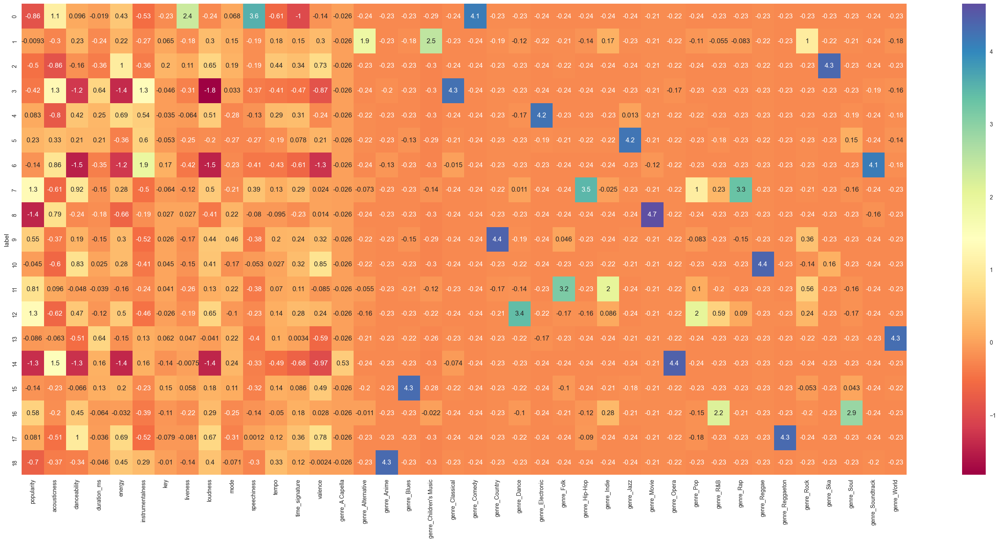

In [37]:
df2_kmeans1 = pd.DataFrame(data=data2_scal, columns=df2.columns)
df2_kmeans1["label"] = kmeans1

tmp = df2_kmeans1.groupby(by=["label"]).mean()

plt.figure(figsize=(35, 15))
sns.heatmap(tmp, cmap="Spectral", annot=True)

C:\Users\gaofu\AppData\Local\Temp\ipykernel_22804\975879182.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df2_kmeans1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_22804\975879182.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df2_kmeans1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_22804\975879182.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df2_kmeans1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_22804\975879182.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df2_kmeans1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_

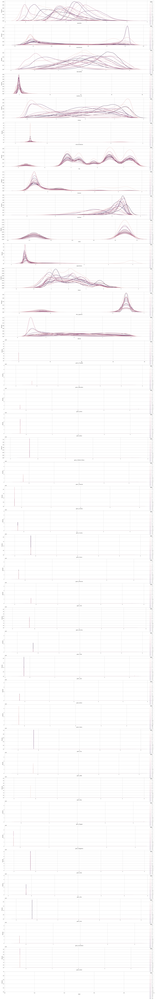

In [38]:
fig, axes = plt.subplots(len(df2_kmeans1.columns), figsize=(30, 200))

for i, c in enumerate(df2_kmeans1.columns): 
    sns.kdeplot(df2_kmeans1, x=c, hue="label", ax=axes[i])

plt.show()

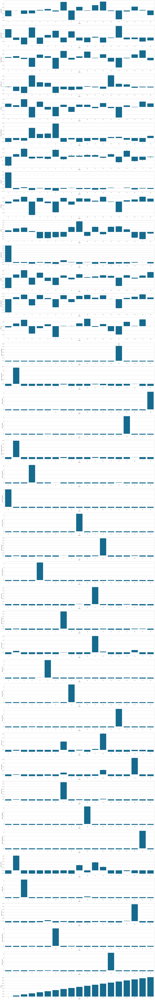

In [39]:
fig, axes = plt.subplots(len(df2_kmeans1.columns), figsize=(30, 200))

for i, c in enumerate(df2_kmeans1.columns): 
    sns.barplot(df2_kmeans1, y=c, x="label", ax=axes[i])

plt.show()

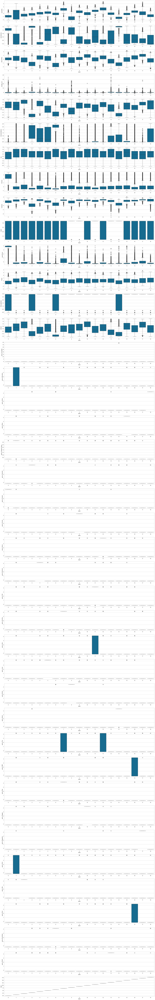

In [40]:
fig, axes = plt.subplots(len(df2_kmeans1.columns), figsize=(30, 200))

for i, c in enumerate(df2_kmeans1.columns): 
    sns.boxplot(df2_kmeans1, x="label", y=c, ax=axes[i])

plt.show()

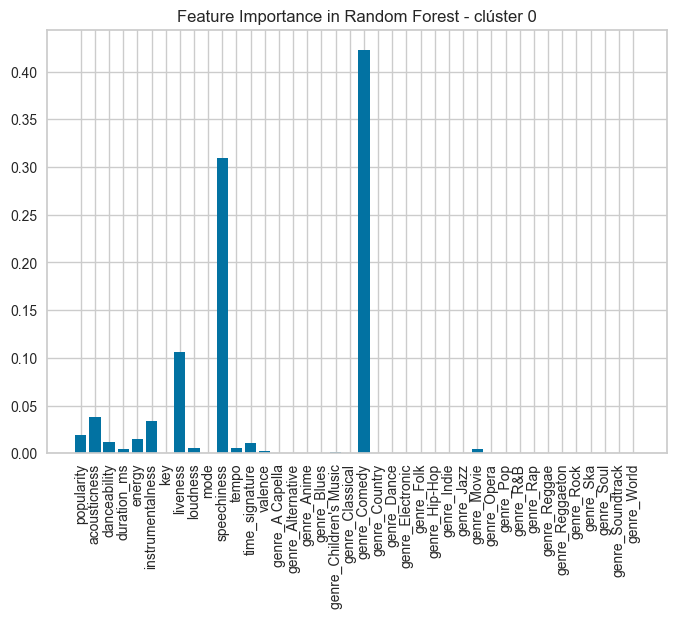

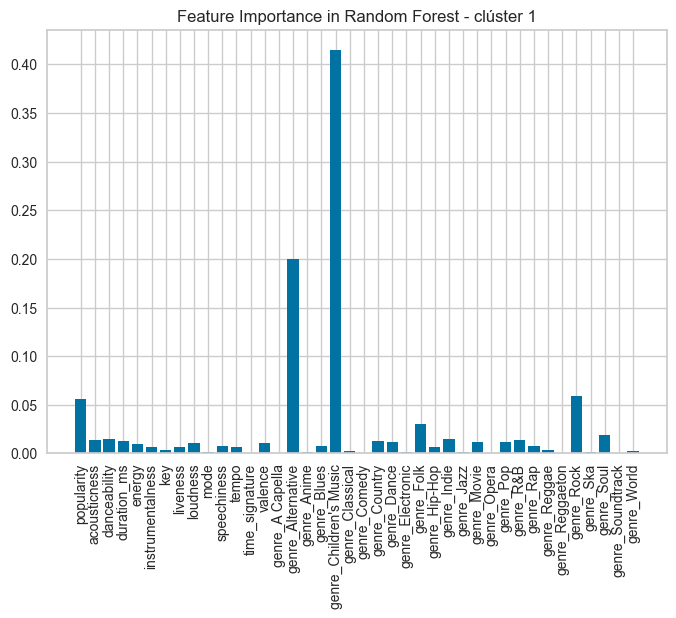

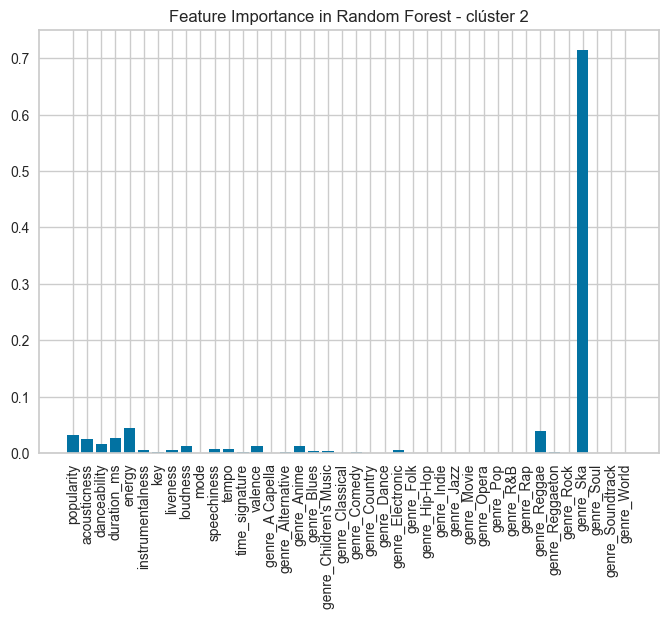

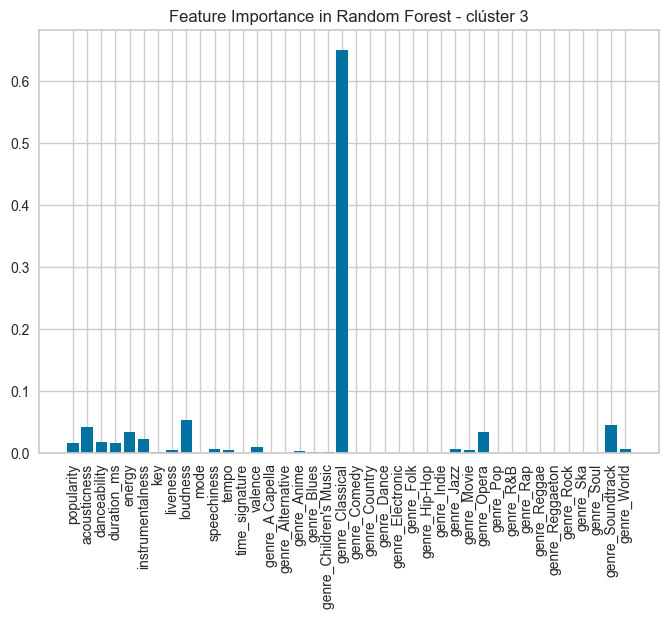

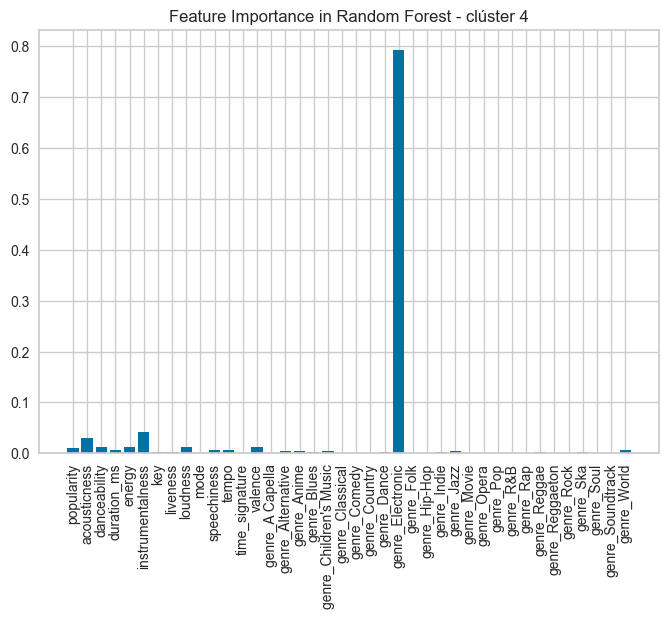

...

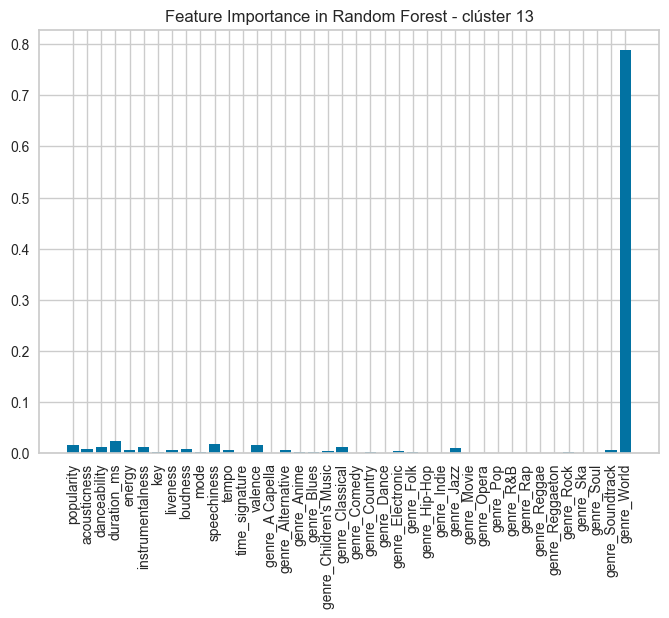

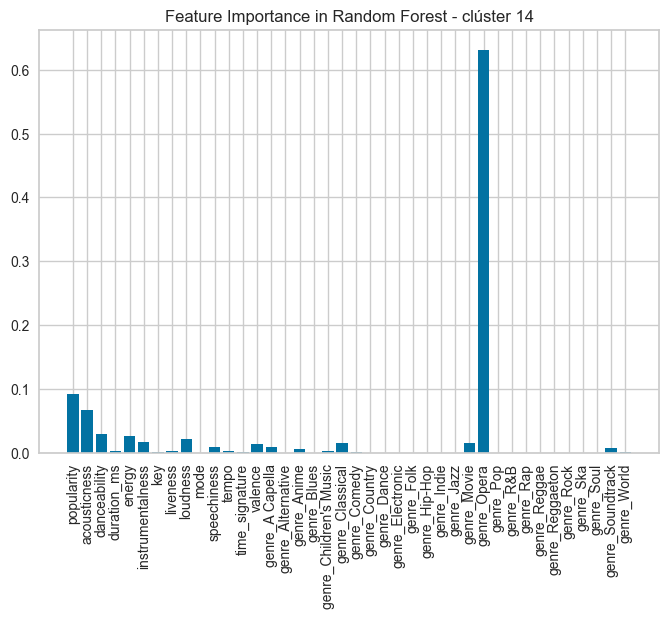

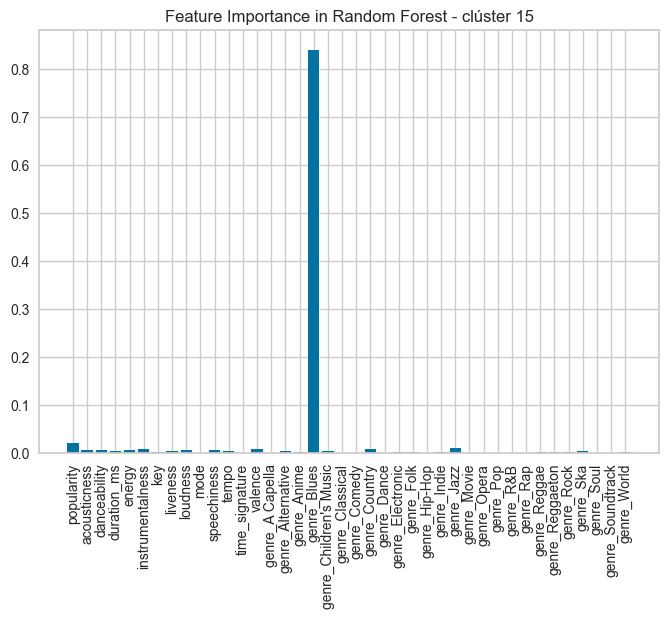

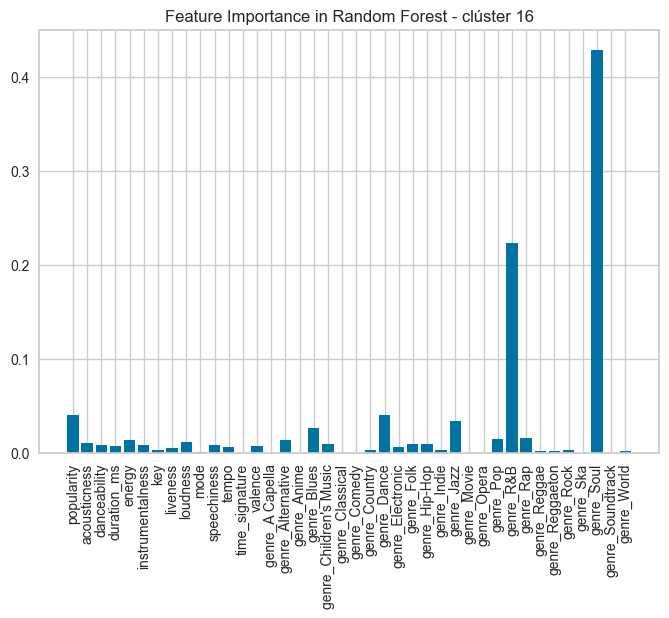

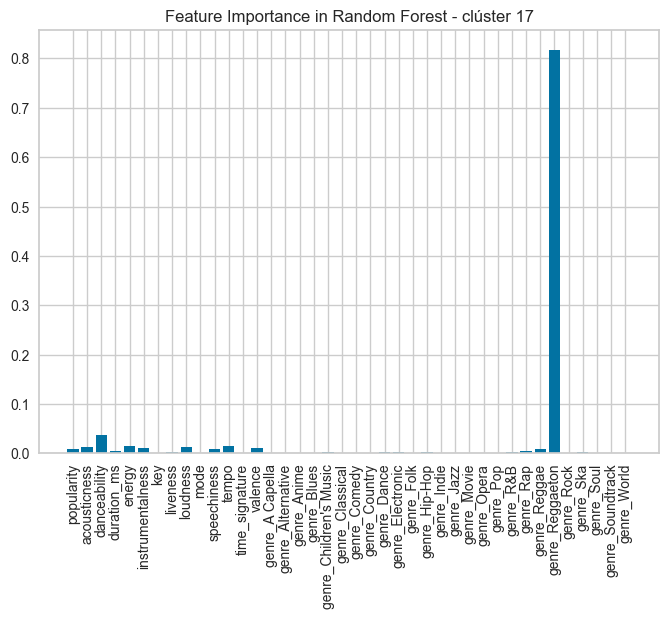

In [55]:
from sklearn.ensemble import RandomForestClassifier


for i in range(len(set(kmeans1))-1):
    df2_kmeans1["cluster_"+str(i)] = (df2_kmeans1["label"] == i)

    clf = RandomForestClassifier(random_state=1)
    clf.fit(df2_kmeans1.iloc[:, 0:40].values, df2_kmeans1["cluster_"+str(i)].values)

    importance = clf.feature_importances_
    #plt.bar(range(num.shape[1]), importance)
    plt.bar(range(40), importance)
    plt.xticks(range(40), df2_kmeans1.columns[0:40], rotation=90)
    plt.title("Feature Importance in Random Forest - clúster " + str(i))
    plt.show()

# Random songs

In [41]:
cluster_labels = sorted([label for label in set(hdbscan1) if label != -1]) #totes les labels del model
sizes = {label: int((hdbscan1 == label).sum()) for label in cluster_labels} #quanitat de cancos en cada label

random_index = np.random.RandomState(42).randint(len(data2_scal)) #index de canço random
random_label = hdbscan1[random_index] #label de canço random

cluster_index = np.where(hdbscan1 == random_label)[0] #index de cancons amb label de canço random 

recomancio = 2
random_recomancio_index = np.random.RandomState(42).choice(cluster_index, size=recomancio, replace=False) #index de 

#print("Nom canço:", canciones.loc[:, "track_name"][random_index].values)
#print("Nom artista:", canciones.loc[:, "artist_name"][random_index].values)
print("Nom canço:", canciones["track_name"][random_index])
print("Nom artista:", canciones["artist_name"][random_index])
print("Label:", hdbscan1[random_index])
print("Cançons disponibles:", sizes[random_label])

for i in range(recomancio): 
    print("RECOMANCIO", i)
    print("Nom canço:", canciones["track_name"][random_recomancio_index[i]])
    print("Nom artista:", canciones["artist_name"][random_recomancio_index[i]])
    print("Label:", hdbscan1[random_recomancio_index[i]])

Nom canço: Donde Esta Mi Gata
Nom artista: Yandel
Label: 0
Cançons disponibles: 176648
RECOMANCIO 0
Nom canço: Forever
Nom artista: Taska Black
Label: 0
RECOMANCIO 1
Nom canço: The Fight Song
Nom artista: Marilyn Manson
Label: 0
